<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Follicular-lymphoma" data-toc-modified-id="Follicular-lymphoma-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Follicular lymphoma</a></span></li><li><span><a href="#Multiple-myeloma" data-toc-modified-id="Multiple-myeloma-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Multiple myeloma</a></span></li><li><span><a href="#Acute-lymphoblastic-leukemia" data-toc-modified-id="Acute-lymphoblastic-leukemia-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Acute lymphoblastic leukemia</a></span></li></ul></div>

The notebook reproduces the analysis of CAR target expression in follicular lymphoma (FL), multiple myeloma (MM) and acute lymphoblastic leukemia (B-ALL) (Fig. 2 and Suppl. Fig. 1).

In [5]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb

import warnings


import os
from os import listdir
from os.path import isfile, join
import sys
import psutil


import anndata
import scanpy.external as sce

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
sc.settings.verbosity = 3

#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.set_figure_params(vector_friendly=True, color_map='Reds',
                     dpi=200,transparent=True, fontsize=14)

palette=['#3519ED','#EDFBA8', '#4D2E6A', '#0ECDB4', '#0C23B5', '#92BF0D', '#51F2E4', '#1CB09D', '#BFC1D4', '#A98BF3', '#98D1C6', '#9A5E72', '#B89327', '#6704A5', '#0F64B2', '#A69CF3', '#D97C2E',
        '#321795', '#7E2649', '#65A813', '#734E0F', '#D14FBC', '#2CFA50', '#83610A', '#841032', '#04D8E3', '#8605BA', '#1EF60C', '#602587', '#F9AD1B', '#2BD738', '#C8E239', '#46D1BC',
        '#465A01', '#70C51E', '#924DFB', '#5D28E4', '#712E8D', '#30F465', '#5287E1', '#D16B7F', '#B8EF72', '#03B15D', '#4290F3', '#5E9063', '#B0E39F', '#3C6205', '#ACE603', '#2DE57A',
         '#052B18', '#69BE75', '#8BE509', '#C37041', '#E218BA', '#5AC097', '#A597C4','#2A13B5', '#823FA7', '#C8F349', '#7C482A', '#A104E5', '#8E3C27', '#1DB457', '#36FDC7', '#60A934', '#F43B78',
        '#74EF61', '#810527', '#6D293F', '#F1A709', '#274F6C', '#104EB5', '#6D02CE', '#B36AE5', '#13F9BA', '#C7281F', '#31572B', '#07D94B', '#B45E18', '#9F73D1', '#3CA059', '#4D6B1C', 
        '#3BA785', '#E3084C', '#A61BF4', '#F3D50A', '#640A32', '#FB0D73', '#AD0126', '#279136', '#480EB1', '#634158', '#FD80E5', '#CF26AE', '#046DB9', '#15F6B8', '#1A047C', '#D14826', 
        '#45D160', '#C6039B', '#D9C23F', '#70829B', '#940ECF', '#9FAB37', '#BA84C7', '#68F275', '#C79EA1', '#6E89B7', '#712D6C', '#F51D8C', '#D564E0', '#24EA18', '#459C71', '#23F50B', 
        '#3E57C8', '#6D78F9', '#07EC9F', '#3078C5', '#53EC0A','#D283E5', '#16039B', '#61E0A8', '#10A659', '#52374A', '#B31EC4', '#254D10', '#D5B0F4', '#A79E35', '#2D0F45', '#562D18', 
        '#ABE562', '#9A0842', '#92165C', '#FCD98A', '#B384DA', '#3CB108', '#2FE04C', '#386CA2', '#423719', '#E540C2', '#C58DE9', '#F6B8E4','#87592B', '#94D53F', '#4AB5E3', '#B0E96C',
        '#AD94E6', '#E237B8', '#21F0B9', '#FB9C73']

In [ ]:
# approved + tumor data
FBCL_genes=['CD19','MS4A1', 'CD22']
MM_genes=['TNFRSF17', 'GPRC5D','CD19','SLAMF7', 'SDC1','NCAM1', 'CD38','KLRK1','CD44']
ALL_genes=['CD19','CD22','MS4A1','IL3RA','ROR1','TNFRSF13C']

# approved but no tumor data
remaining=['CD19','MS4A1','CD22','TNFRSF9','TNFRSF8','TNFRSF13C','CD79A','ROR1']

# Follicular lymphoma

In [8]:
len(FBCL_genes)

3

In [9]:
goi=FBCL_genes

In [7]:
#Load adata
path = '/path/to/data/'
adata = sc.read(path +  '004-Tumor-FollicularLymphoma-FL-Green-2021.h5ad')

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [9]:
adata

AnnData object with n_obs × n_vars = 63136 × 18645
    obs: 'sample_id', 'nCount_RNA', 'nFeature_RNA', 'Ratio.RP', 'Ratio.MT', 'cell_type_in_paper', 'TCR/BCR', 'organism_ontology_term_id', 'tissue_ontology_term_id', 'assay_ontology_term_id', 'disease_ontology_term_id', 'ethnicity_ontology_term_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 'cell_type_ontology_term_id', 'is_primary_data', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'ethnicity', 'development_stage', 'InternDatasetNumber', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'size_factors', 'celltype', 'Malignant', 'donor', 'Organ', 'Organ_Specific', 'Dataset', 'Dataset_status', 'sub_celltype', 'Patient', 'Patient_Number', 'age', 'health_status', 'original_celltype_1', 'original_celltype_2', 'original_celltype_3', 'batch'
    var: 'feature_biotype', 'feature_is_filtered', 'feature_name', 'feature_reference', 'n_cells', 'means', 'dispersions', 'dispersions_norm', 'highly_variable'
    uns: 

In [14]:
adata.X=sp.sparse.csr_matrix.todense(adata.X)

In [17]:
adata.layers['scaled'] = sc.pp.scale(adata,copy=True).X

In [18]:
adata.obs['celltype'].cat.categories

Index(['B cell lymphoma cells', 'B cells', 'Dendritic cells', 'Erythroid cell',
       'Myeloid cells', 'NK cells', 'Plasma cells', 'T cells'],
      dtype='object')

In [11]:
order=['B cell lymphoma cells', 'Plasma cells',
       'B cells', 'T cells','NK cells',
       'Dendritic cells', 'Erythroid cell',
       'Myeloid cells' ]

adata.obs['celltype'].cat.reorder_categories(order, inplace=True)

/var/folders/fj/5ywcjg851092_gqm88cq4t3dt4qvjk/T/ipykernel_79391/2161153203.py:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['celltype'].cat.reorder_categories(order, inplace=True)


In [12]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',dpi=200,transparent=True, fontsize=14)

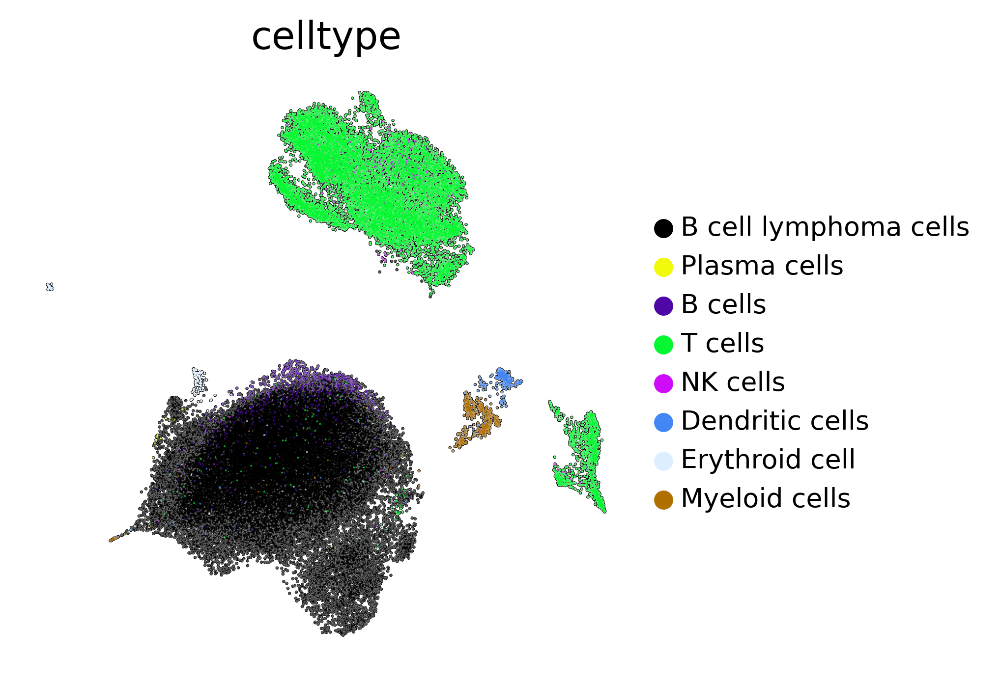

In [25]:
sc.pl.umap(adata, color='celltype', add_outline=True, 
           use_raw=False,wspace=0.25, legend_fontsize='x-small',frameon=False, color_map=mymap)

In [ ]:
ordergenes = ['CD19','CD22','MS4A1']

In [17]:
sc.pl.umap(adata, color=ordergenes, add_outline=True, 
           use_raw=False,wspace=0.25, legend_fontsize='x-small',frameon=False, color_map=mymap,
           vmax=3, 
           vmin=0
          )

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


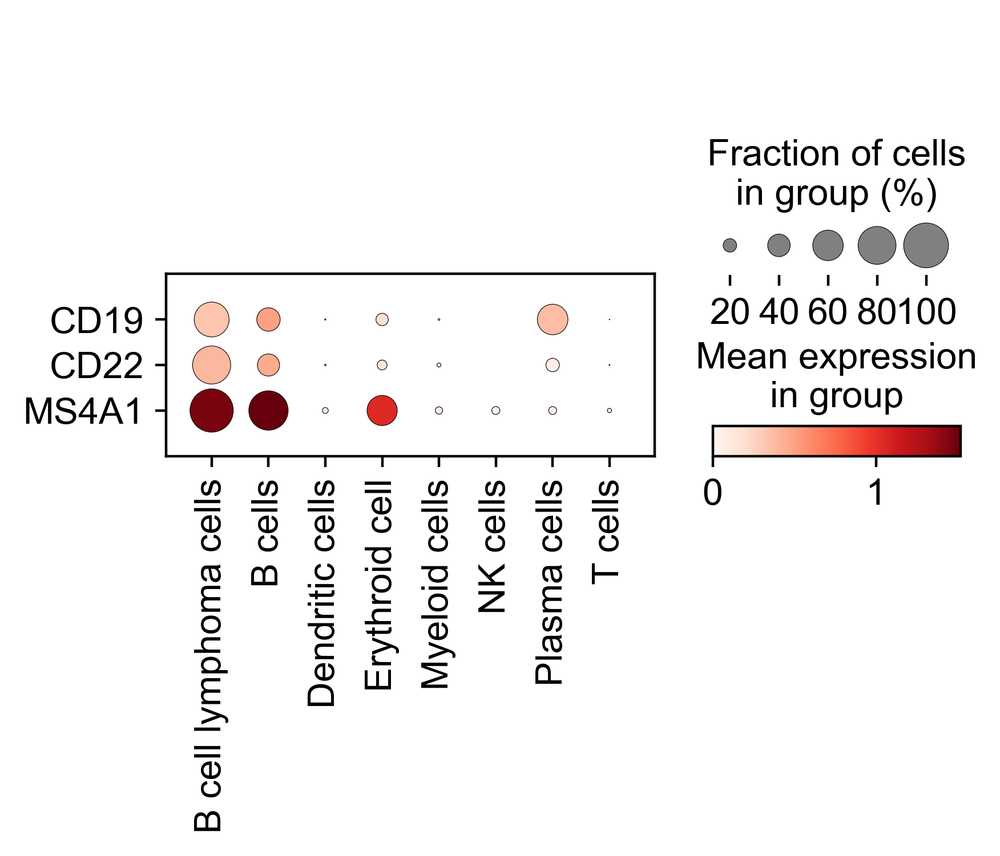

In [18]:
sc.pl.dotplot(adata, var_names=ordergenes, groupby='celltype', 
              dendrogram=False, swap_axes=True, use_raw=False, 
              #vmax=1, 
              #dot_min=0.001, 
              #dot_max=0.6
              )

In [16]:
ix=np.isin(adata.obs['celltype'],['Plasma cells', 'B cells', 'T cells',
       'NK cells', 'Dendritic cells', 'Erythroid cell', 'Myeloid cells']) 
adata_healthy=adata[ix].copy()

ix=np.isin(adata.obs['celltype'],['B cell lymphoma cells']) 
adata_tumor=adata[ix].copy()

In [17]:
print(len(adata_healthy))
print(len(adata_tumor))
print(len(adata))

17498
45638
63136


/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


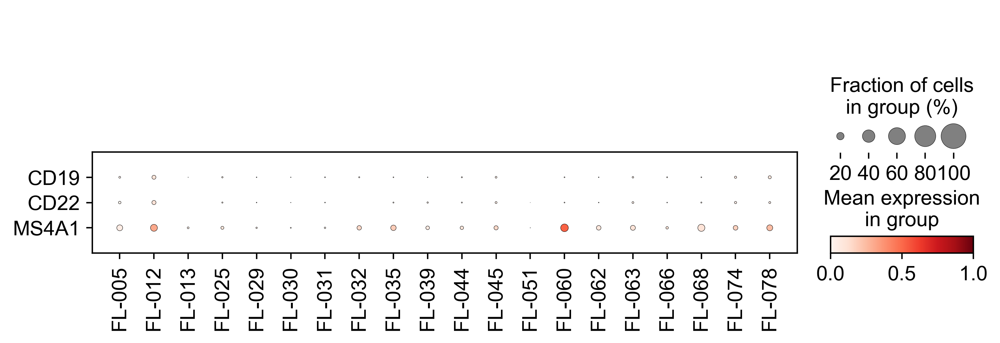

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


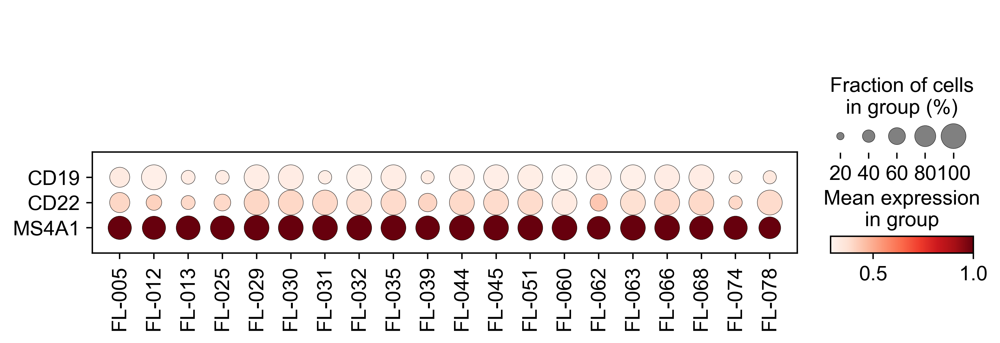

In [18]:
sc.pl.dotplot(adata_healthy, ordergenes, ['Patient'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=1
              )

sc.pl.dotplot(adata_tumor, ordergenes, ['Patient'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=1
              )

In [6]:
#Load Healthy adata
path = '/Users/moritz.thomas/Documents/ZZ_DataFromServer/TumorToxicity/malignant/'


list_of_healthy_datasets = ['001-Tumor-MultipleMyeloma-RRMM-Tirier-2021-RubenBrabenec_TumorProject-batch_combat.h5ad',
                            '015-Tumor-MultipleMyeloma-MM-Cohen-2021-RubenBrabenec_TumorProject-processed.h5ad',
                            #'004-Tumor-FollicularLymphoma-FL-Green-2021-RubenBrabenec_TumorProject-batch_combat.h5ad',

    
                            #'002-Tumor-AcuteMyeloidLeukemia-AML-VanGalen-2019-RubenBrabenec_TumorProject-batch_combat.h5ad',
    
                            #'003-Tumor-HepatocellularCarcinoma-earlyrelapseHCC-Zhong-2021-RubenBrabenec_TumorTargetingProject-batch_combat.h5ad',
                            #'010-Tumor-HepatocellularCarcinoma-HCC-Ma-2021-RubenBrabenec_TumorProject-processed.h5ad',
                            #'011-Tumor-IntrahepaticCholangiocarcinoma-iCCA-Ma-2021-RubenBrabenec_TumorProject-processed.h5ad',

    
                            #'005-Tumor-Glioblastoma-GB-Darmanis-2017-RubenBrabenec_TumorProject-batch_combat.h5ad',
    
                            #'008-Tumor-LungAdenocarcinoma-LA-Kim-2020-RubenBrabenec_TumorProject-batch_combat.h5ad',
    
                            #'009-Tumor-PancreaticDuctalAdenocarcinoma-PDAC-Peng-2019-RubenBrabenec_TumorProject-batch_combat.h5ad',
                            #'012-Tumor-PancreaticDuctalAdenocarcinoma-PDAC-Lin-2021-RubenBrabenec_TumorProject-processed.h5ad'
                            #'014-Tumor-PancreaticDuctalAdenocarcinoma-PDAC-Krieger-2021-RubenBrabenec_TumorProject-processed.h5ad'
                          ]

# Multiple myeloma

In [6]:
goi=MM_genes

In [ ]:
#Load adata
path = '/path/to/data/'
adata = sc.read(path +  '001-Tumor-MultipleMyeloma-MM-Tirier-2021.h5ad')

In [10]:
adata

AnnData object with n_obs × n_vars = 212400 × 23186
    obs: 'Cell_barcode', 'orig_ident', 'Patient_old', 'Patient', 'PID_sample_new', 'timepoint', 'sorting', 'major_celltype', 'celltype', 'major_population', 'tumor_clone', 'sc_gain_1q', 'Malignant', 'Organ', 'Dataset', 'Dataset_status', 'InternDatasetNumber', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'size_factors', 'sub_celltype', 'Organ_Specific', 'Patient_Number', 'age', 'sex', 'ethnicity', 'health_status', 'original_celltype_1', 'original_celltype_2', 'original_celltype_3', 'batch'
    var: 'n_cells', 'means', 'dispersions', 'dispersions_norm', 'highly_variable'
    uns: 'celltype_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [ ]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [19]:
adata.layers['scaled'] = sc.pp.scale(adata,copy=True).X

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [10]:
adata.obs['celltype'].cat.categories

Index(['B cells', 'Common lymphoid progenitor cells', 'Dendritic cells',
       'Erythroid cells', 'Erythroid progenitor cells',
       'Granulocyte-monocyte progenitor cells', 'Hematopoietic stem cells',
       'Mast cells', 'Megakaryocyte progenitor cells', 'Monocytes',
       'Multipotent progenitor cells', 'Myeloma', 'NK cells', 'Plasma cells',
       'T cells'],
      dtype='object')

In [12]:
order=[ 'Myeloma', 'Plasma cells',
       'B cells','T cells','NK cells', 
       'Dendritic cells','Monocytes', 'Mast cells','Erythroid cells',
       'Erythroid progenitor cells',
       'Megakaryocyte progenitor cells','Granulocyte-monocyte progenitor cells', 
       'Common lymphoid progenitor cells', 'Multipotent progenitor cells',
       'Hematopoietic stem cells',
       ]

adata.obs['celltype'].cat.reorder_categories(order, inplace=True)

/var/folders/fj/5ywcjg851092_gqm88cq4t3dt4qvjk/T/ipykernel_80189/1608338706.py:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['celltype'].cat.reorder_categories(order, inplace=True)


In [10]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',dpi=200,transparent=True, fontsize=14)

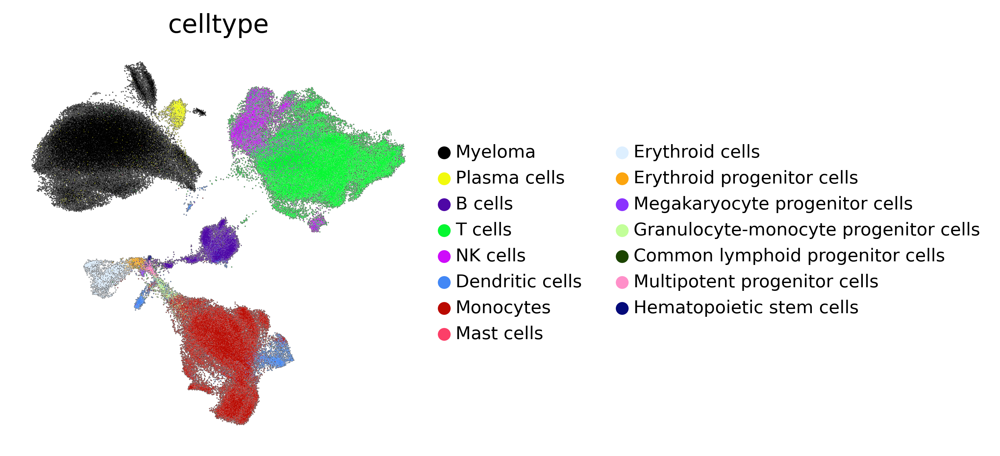

In [18]:
sc.pl.umap(adata, color='celltype', add_outline=True, 
           use_raw=False,wspace=0.25, legend_fontsize='x-small',frameon=False, color_map=mymap)

In [13]:
ordergenes=['TNFRSF17','SDC1','CD38', 'SLAMF7', 'GPRC5D', 'NCAM1','CD19','KLRK1', 'CD44']

In [15]:
# umap of goi that are present
sc.pl.umap(adata, color=np.array(ordergenes)[np.isin(np.array(ordergenes), adata.var.index)], add_outline=True, 
           use_raw=False,wspace=0.25, legend_fontsize='x-small',frameon=False, color_map=mymap,
           vmax=2, vmin=0, ncols=5
          )

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


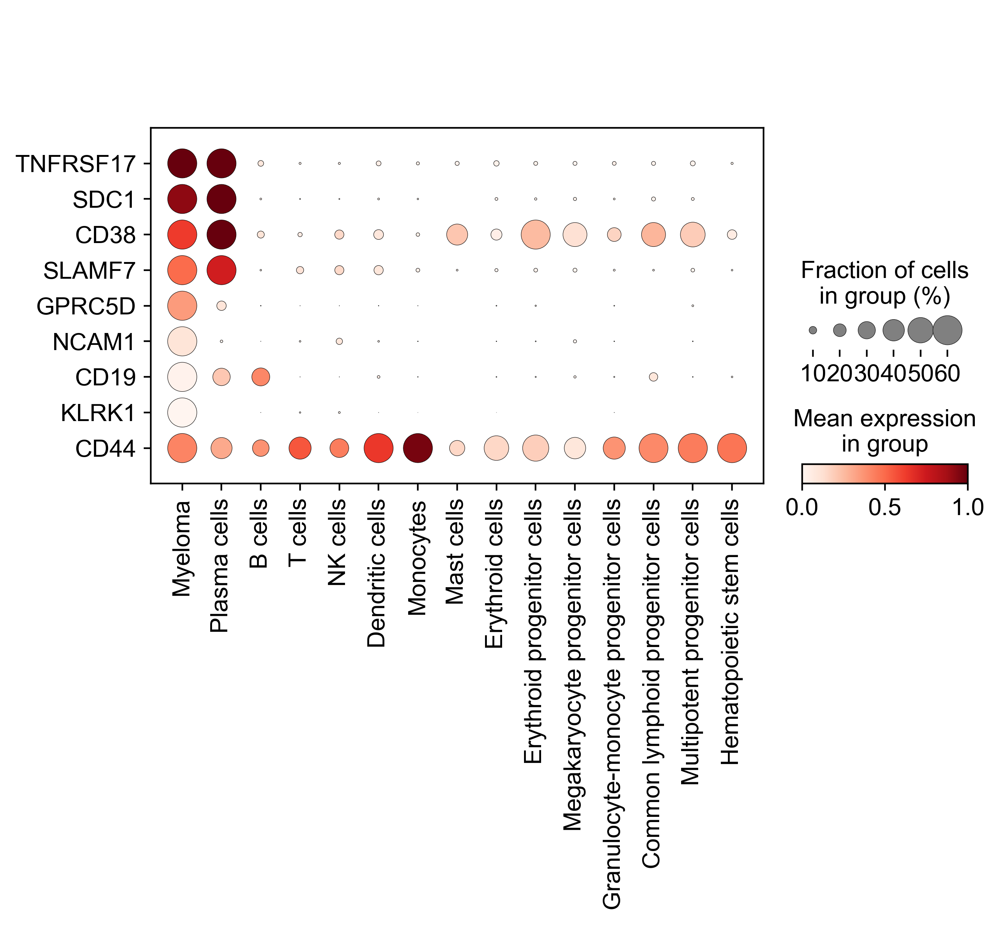

In [19]:
sc.pl.dotplot(adata,ordergenes,
              ['celltype'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=0.6
              )

In [12]:
adata.obs['celltype'].cat.categories

Index(['Myeloma', 'Plasma cells', 'B cells', 'T cells', 'NK cells',
       'Dendritic cells', 'Monocytes', 'Mast cells', 'Erythroid cells',
       'Erythroid progenitor cells', 'Megakaryocyte progenitor cells',
       'Granulocyte-monocyte progenitor cells',
       'Common lymphoid progenitor cells', 'Multipotent progenitor cells',
       'Hematopoietic stem cells'],
      dtype='object')

In [13]:
ix=np.isin(adata.obs['celltype'],['Myeloma']) 
adata_tumor=adata[ix].copy()

In [ ]:
ix=np.isin(adata.obs['celltype'],['B cells', 'Common lymphoid progenitor cells', 'Dendritic cells',
       'Erythroid cells', 'Erythroid progenitor cells',
       'Granulocyte-monocyte progenitor cells', 'Hematopoietic stem cells',
       'Mast cells', 'Megakaryocyte progenitor cells', 'Monocytes',
       'Multipotent progenitor cells', 'NK cells', 'Plasma cells',
       'T cells']) 
adata_healthy=adata[ix].copy()

In [14]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',dpi=200,
                     dpi_save=600, transparent=True, fontsize=14)

In [ ]:
sc.pl.dotplot(adata_tumor, ordergenes, ['Patient'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=1,
              save='MM_patients_malignant.pdf'
              )

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


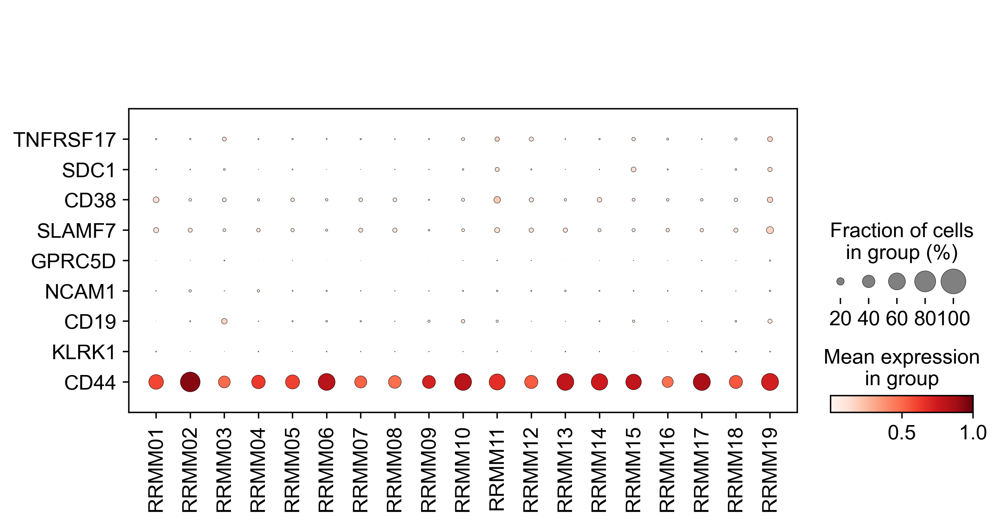

In [16]:
sc.pl.dotplot(adata_healthy, ordergenes, ['Patient'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=1,
              save='MM_patients_healthy.pdf'
              )

# Acute lymphoblastic leukemia

In [348]:
goi=ALL_genes

In [ ]:
#Load adata
path = '/path/to/data/'
adata = sc.read(path +  '001-Tumor-AcuteLymphoblasticLeukemia-ALL-Khabirova-2022.h5ad')

In [351]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

In [374]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',dpi=200,transparent=True, fontsize=14)

In [393]:
ix=np.isin(adata.obs['celltype'],['B_lineage (malignant)',  
                                  'T_NK (malignant)',
                                  'Monocytes (malignant)', 
                                  'Progenitors (malignant)',
                                  
                                  'B_lineage',  
                                  'T_NK',
                                  'Monocytes',
                                  'Progenitors',
                                  'Megakaryocytes',
                                  'DC', 
                                  'Eosinophile/Basophile/Mast',
                                  'Erythroid', 
                                  'Neutrophils', 
                                  'Stroma']) 
adata=adata[ix].copy()

In [396]:
adata.obs['celltype'].cat.reorder_categories(['B_lineage (malignant)',  
                                  'T_NK (malignant)',
                                  'Monocytes (malignant)', 
                                  'Progenitors (malignant)',
                                  
                                  'B_lineage',  
                                  'T_NK',
                                  'Monocytes',
                                  'Progenitors',
                                  'Megakaryocytes',
                                  'DC', 
                                  'Eosinophile/Basophile/Mast',
                                  'Erythroid', 
                                  'Neutrophils', 
                                  'Stroma'], inplace=True)

In [423]:
adata

AnnData object with n_obs × n_vars = 27654 × 33712
    obs: 'patient_cancer', 'patient', 'disease', 'timepoint', 'age (months)', 'sex', 'cancer', 'orig.ident', 'broad_fig1_cell.labels', 'predictions', 'cell.labels', 'stage', 'batch', 'dataset', 'broad_fig1_cell.labels_final', 'celltype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'umap', 'tsne', 'broad_fig1_cell.labels_final_colors', 'predictions_colors', 'broad_fig1_cell.labels_colors', 'dataset_colors', 'celltype_colors'
    obsm: 'X_umap', 'X_scANVI', 'X_tsne'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [3]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',
                     dpi=200,transparent=True, fontsize=14)

In [4]:
ordergenes=['CD19','IL3RA', 'TNFRSF13C', 'CD22','ROR1','MS4A1']

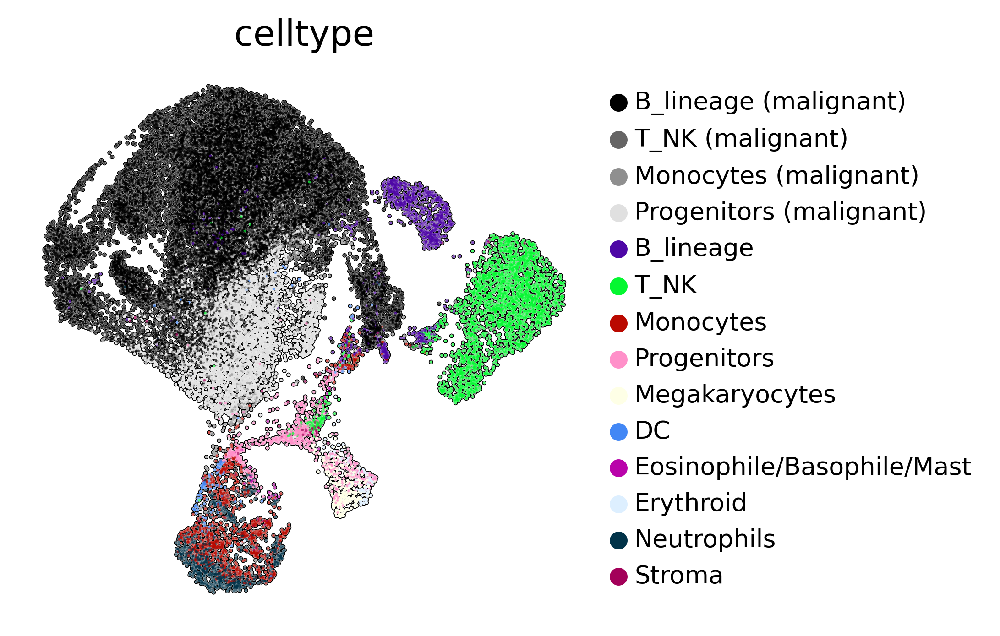

In [10]:
sc.pl.umap(adata, color='celltype', add_outline=True, 
           use_raw=False,wspace=0.25, legend_fontsize='x-small',frameon=False, color_map=mymap)

In [11]:
# umap of goi that are present
sc.pl.umap(adata, color=ordergenes, add_outline=True, 
           use_raw=False,wspace=0.25, legend_fontsize='x-small',frameon=False, color_map=mymap,
           vmax=2, 
           vmin=0, ncols=5
          )

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


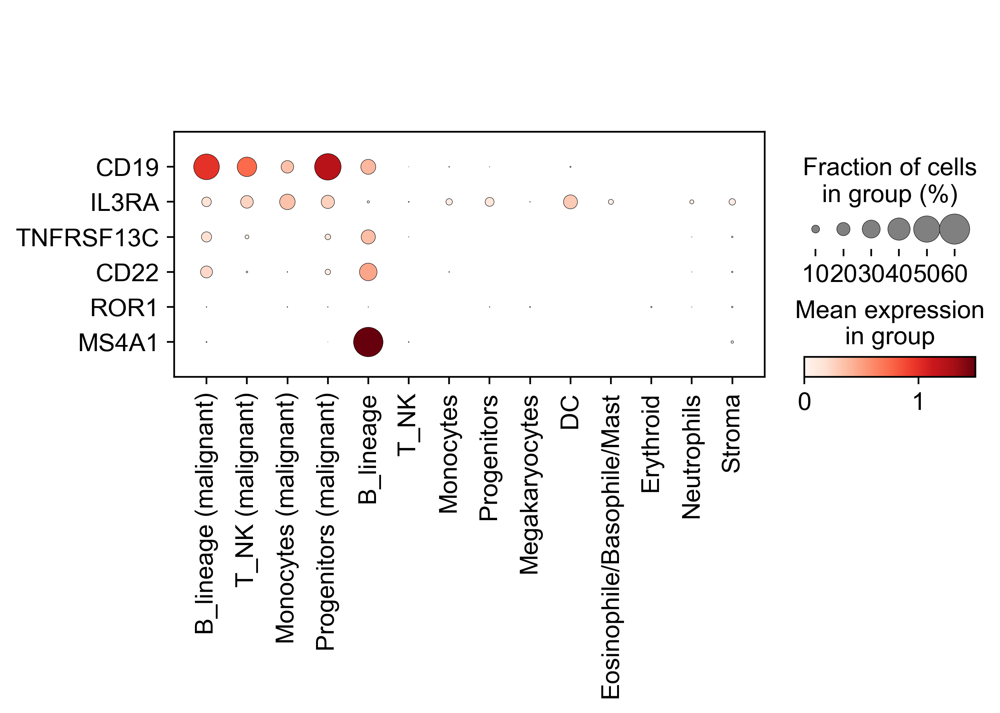

In [12]:
sc.pl.dotplot(adata, ordergenes, ['celltype'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1.5, 
              #dot_min=0.001, 
              dot_max=0.6
              )

In [7]:
ix=np.isin(adata.obs['celltype'],['B_lineage', 'T_NK', 'Monocytes',
       'Progenitors', 'Megakaryocytes', 'DC', 'Eosinophile/Basophile/Mast',
       'Erythroid', 'Neutrophils', 'Stroma']) 
adata_healthy=adata[ix].copy()

ix=np.isin(adata.obs['celltype'],['B_lineage (malignant)', 'T_NK (malignant)', 'Monocytes (malignant)',
                                  'Progenitors (malignant)']) 
adata_tumor=adata[ix].copy()

In [8]:
print(len(adata_healthy))
print(len(adata_tumor))
print(len(adata))

6740
20914
27654


/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


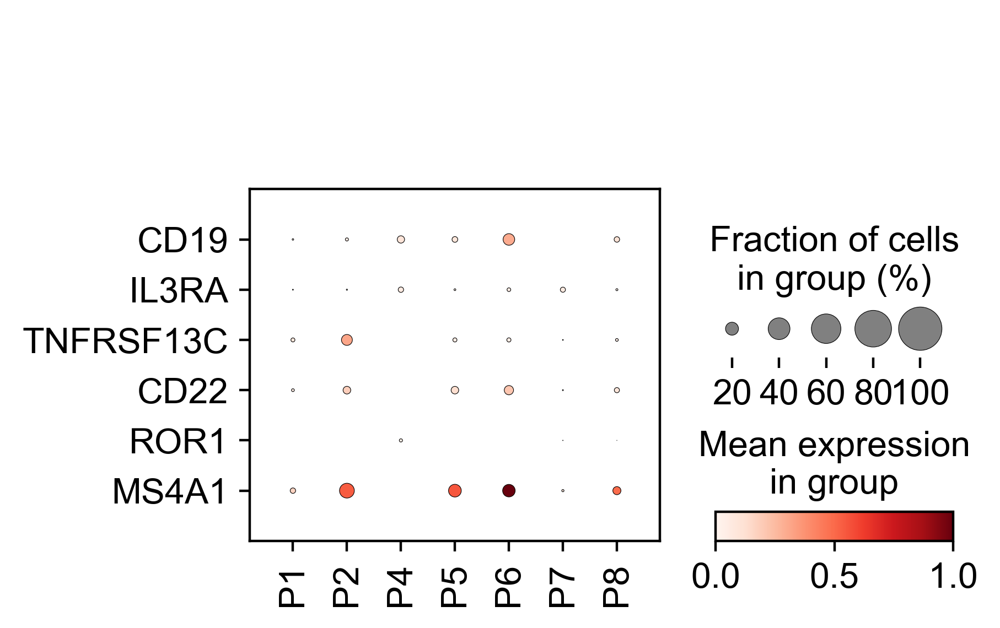

/Users/moritz.thomas/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


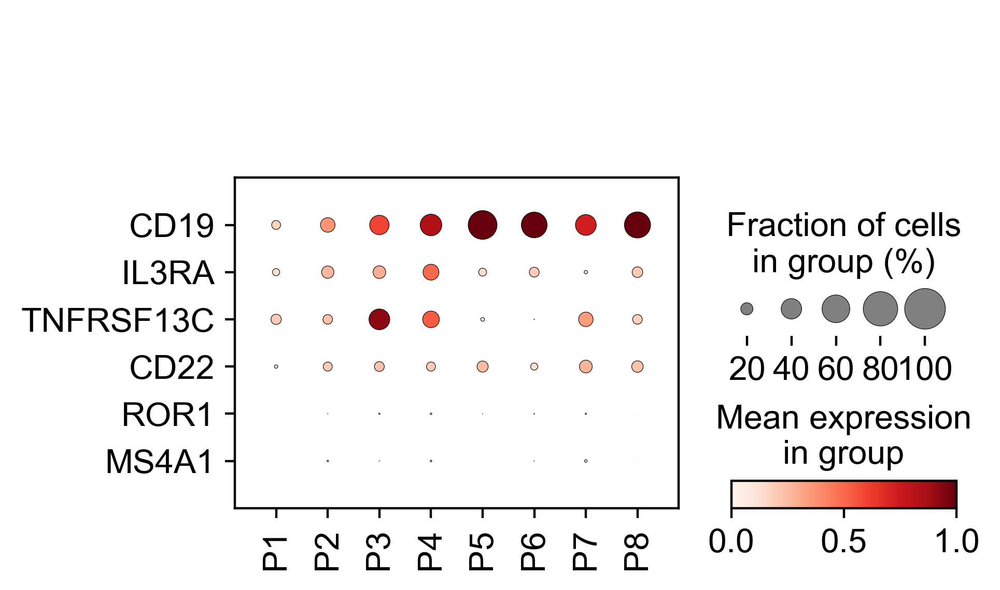

In [10]:
sc.pl.dotplot(adata_healthy, ordergenes, ['patient'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=1
              )

sc.pl.dotplot(adata_tumor, ordergenes, ['patient'], 
              dendrogram=False, swap_axes=True, use_raw=False, 
              vmax=1, 
              #dot_min=0.001, 
              dot_max=1
              )